##### Purpose of the notebook ####

Run inferCNV on the CosMX data using the immune cells as a reference

In [1]:
import scanpy as sc
import infercnvpy as cnv
import matplotlib.pyplot as plt
import warnings

In [ ]:
adata = sc.read_h5ad("/home/augusta/SSS_mount/insituCNV/data/WTx-CosMx_TVA/WTx-CosMx/adata_2080151_processed_metadata_processed.h5ad")

#### Generate moments for the data to smoothen it

In [ ]:
sc.pp.subsample(adata,0.1)

In [ ]:
import warnings
import numpy as np
from scipy.sparse import csr_matrix, issparse
from scvelo import logging as logg
from scvelo import settings
from scvelo.preprocessing.neighbors import get_connectivities, get_n_neighs, neighbors, verify_neighbors
from scvelo.preprocessing.utils import normalize_per_cell, not_yet_normalized


def moments(
    data,
    n_neighbors=30,
    n_pcs=None,
    mode="connectivities",
    method="umap",
    use_rep=None,
    use_highly_variable=True,
    copy=False,
):
    """Computes moments for velocity estimation.

    First-/second-order moments are computed for each cell across its nearest neighbors,
    where the neighbor graph is obtained from euclidean distances in PCA space.

    Arguments:
    ---------
    data: :class:`~anndata.AnnData`
        Annotated data matrix.
    n_neighbors: `int` (default: 30)
        Number of neighbors to use.
    n_pcs: `int` (default: None)
        Number of principal components to use.
        If not specified, the full space is used of a pre-computed PCA,
        or 30 components are used when PCA is computed internally.
    mode: `'connectivities'` or `'distances'`  (default: `'connectivities'`)
        Distance metric to use for moment computation.
    method : {{'umap', 'hnsw', 'sklearn', `None`}}  (default: `'umap'`)
        Method to compute neighbors, only differs in runtime.
        Connectivities are computed with adaptive kernel width as proposed in
        Haghverdi et al. 2016 (https://doi.org/10.1038/nmeth.3971).
    use_rep : `None`, `'X'` or any key for `.obsm` (default: None)
        Use the indicated representation. If `None`, the representation is chosen
        automatically: for .n_vars < 50, .X is used, otherwise ‘X_pca’ is used.
    use_highly_variable: `bool` (default: True)
        Whether to use highly variable genes only, stored in .var['highly_variable'].
    copy: `bool` (default: `False`)
        Return a copy instead of writing to adata.

    Returns
    -------
    Ms: `.layers`
        dense matrix with first order moments of spliced counts.
    Mu: `.layers`
        dense matrix with first order moments of unspliced counts.
    """
    adata = data.copy() if copy else data

    layers = [layer for layer in {"raw"} if layer in adata.layers]
    if any([not_yet_normalized(adata.layers[layer]) for layer in layers]):
        normalize_per_cell(adata)

    if n_neighbors is not None and n_neighbors > get_n_neighs(adata):
        warnings.warn(
            "Automatic neighbor calculation is deprecated since scvelo==0.4.0 and will be removed in a future version "
            "of scVelo. Please compute neighbors first with Scanpy.",
            DeprecationWarning,
            stacklevel=2,
        )
        neighbors(
            adata,
            n_neighbors=n_neighbors,
            use_rep=use_rep,
            use_highly_variable=use_highly_variable,
            n_pcs=n_pcs,
            method=method,
        )
    verify_neighbors(adata)

    if "spliced" not in adata.layers.keys() or "unspliced" not in adata.layers.keys():
        logg.info(f"computing moments based on {mode}", r=True)
        connectivities = get_connectivities(
            adata, mode, n_neighbors=n_neighbors, recurse_neighbors=False
        )
        adata.layers["Ms"] = (
            csr_matrix.dot(connectivities, csr_matrix(adata.layers["raw"]))
            .astype(np.float32)
            .toarray()
        )
    return adata if copy else None

In [ ]:
moments(adata, n_neighbors=30)

#### Run infercnv

Use the metadata from the processed SCE objects, from which we could not extract the counts

In [18]:
# We provide all immune cell types as "normal cells".
cnv.tl.infercnv(
    adata,
    layer = 'raw',
    window_size=100,
    reference_key = 'add_sub',
    reference_cat = ['immune', 'stromal']
)

# We provide all immune cell types as "normal cells".

  0%|          | 0/100 [00:00<?, ?it/s]

#### Cluster the cells based on their CNV profiles

In [19]:
cnv.tl.pca(adata)
cnv.pp.neighbors(adata)

In [20]:
cnv.tl.leiden(adata,resolution=0.2, n_iterations = 2)

In [21]:
cnv.tl.cnv_score(adata)

#### Plot CNV heatmaps

/home/augusta/anaconda3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/tools/_utils.py:41: UserWarning: You’re trying to run this on 1571 dimensions of `.X`, if you really want this, set `use_rep='X'`.
         Falling back to preprocessing with `sc.pp.pca` and default params.
  warnings.warn(


categories: 0, 1, 2, etc.
var_group_labels: chr1, chr2, chr3, etc.


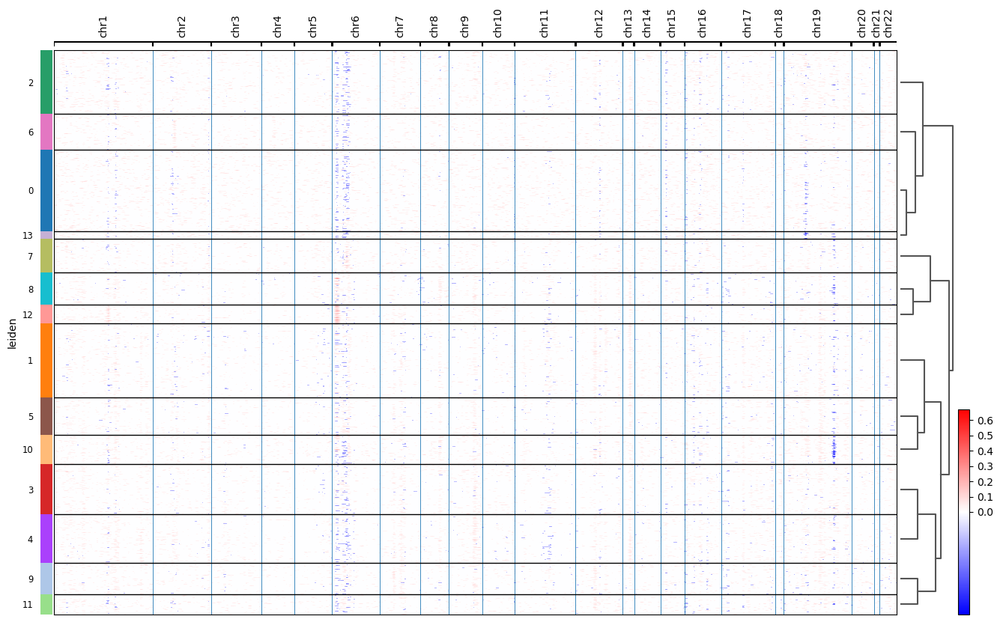

In [22]:
cnv.pl.chromosome_heatmap(adata, groupby="leiden", dendrogram=True)

/home/augusta/anaconda3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/tools/_utils.py:41: UserWarning: You’re trying to run this on 1571 dimensions of `.X`, if you really want this, set `use_rep='X'`.
         Falling back to preprocessing with `sc.pp.pca` and default params.
  warnings.warn(


categories: epithelia, immune, stromal
var_group_labels: chr1, chr2, chr3, etc.


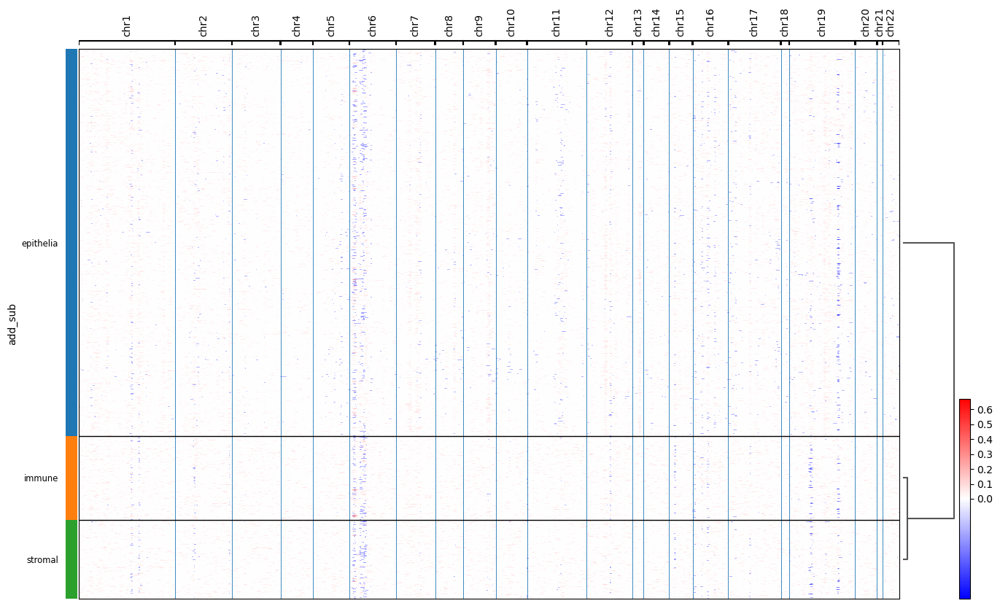

In [23]:
cnv.pl.chromosome_heatmap(adata, groupby="add_sub", dendrogram=True)

Note:

/home/augusta/anaconda3/envs/scanpy_env/lib/python3.12/site-packages/scanpy/tools/_utils.py:41: UserWarning: You’re trying to run this on 1571 dimensions of `.X`, if you really want this, set `use_rep='X'`.
         Falling back to preprocessing with `sc.pp.pca` and default params.
  warnings.warn(


categories: BC mem., DC, EC cap., etc.
var_group_labels: chr1, chr2, chr3, etc.


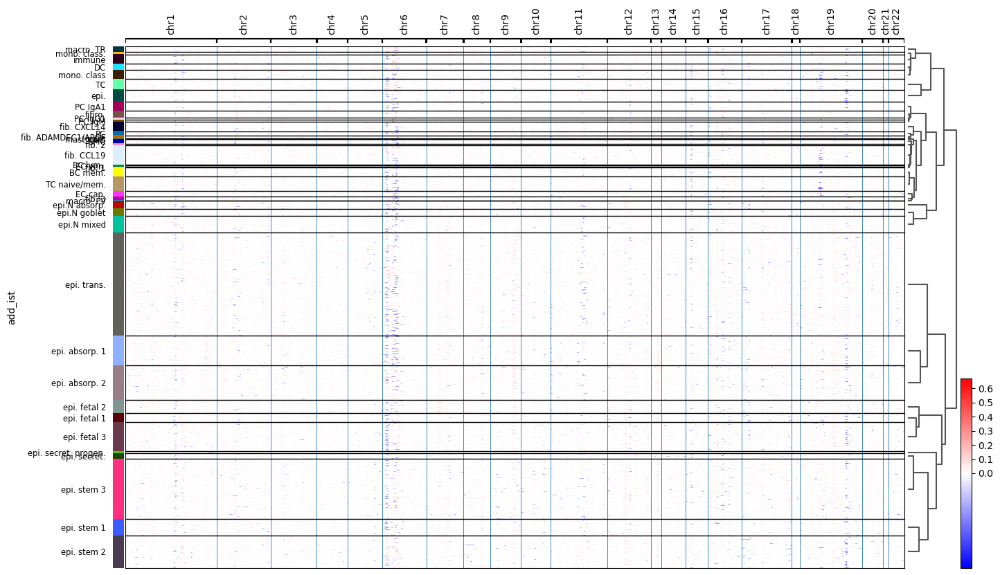

In [24]:
cnv.pl.chromosome_heatmap(adata, groupby="add_ist", dendrogram=True)

In [25]:
sc.tl.dendrogram(adata, groupby='cnv_leiden')

categories: 0, 1
var_group_labels: chr1, chr2, chr3, etc.


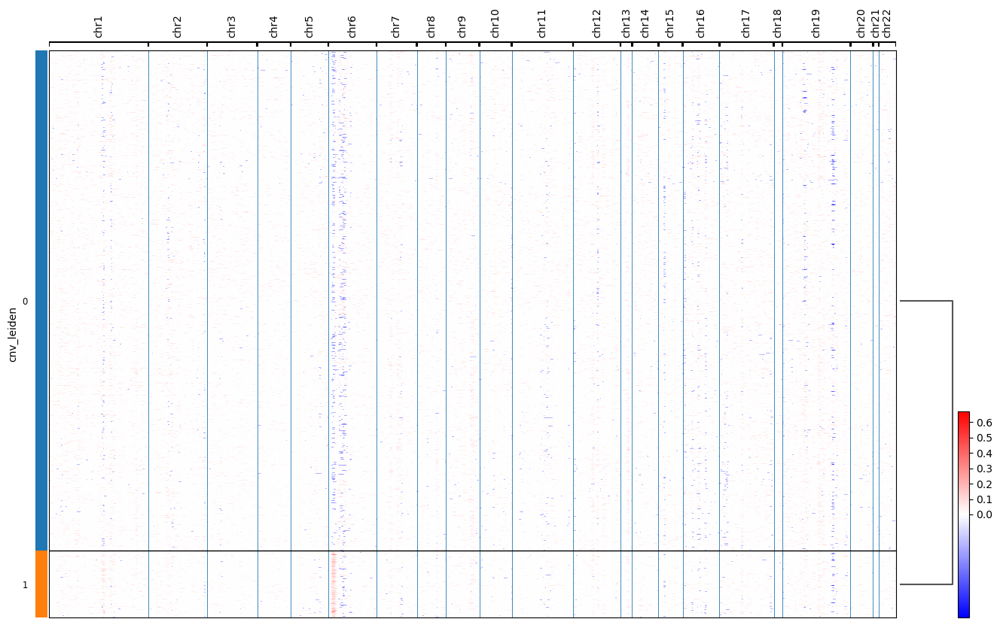

In [26]:
cnv.pl.chromosome_heatmap(adata, groupby="cnv_leiden", dendrogram=True)

Note: there seems to be three major clusters with different CNV profiles, where nbr 1 have more CNVs than the others, notably a gain in chr 6. 

In [27]:
adata

AnnData object with n_obs × n_vars = 497627 × 18555
    obs: 'Unnamed: 0', 'fov', 'Area', 'AspectRatio', 'CenterX_local_px', 'CenterY_local_px', 'Width', 'Height', 'Mean.PanCK', 'Max.PanCK', 'Mean.CD68_CK8_18', 'Max.CD68_CK8_18', 'Mean.CD298_B2M', 'Max.CD298_B2M', 'Mean.CD45', 'Max.CD45', 'Mean.DAPI', 'Max.DAPI', 'cell_id', 'version', 'Run_name', 'Run_Tissue_name', 'tissue', 'Panel', 'assay_type', 'slide_ID', 'CenterX_global_px', 'CenterY_global_px', 'cell_ID', 'unassignedTranscripts', 'nCount_RNA', 'nFeature_RNA', 'nCount_negprobes', 'nFeature_negprobes', 'nCount_falsecode', 'nFeature_falsecode', 'Area.um2', 'cell', 'sid', 'add_cell_id', 'add_ist', 'add_sub', 'cnv_leiden', 'n_counts', 'cnv_score'
    var: 'Unnamed: 0', 'start', 'end', 'width', 'names', 'gene_id', 'symbol', 'ensg', 'chromosome'
    uns: 'cnv', 'cnv_neighbors', 'cnv_leiden', 'add_sub_colors', 'pca', 'dendrogram_add_sub', 'add_ist_colors', 'dendrogram_add_ist', 'cnv_leiden_colors', 'dendrogram_cnv_leiden', 'log1p', 'neig

#### Plot PCA and UMAPs

In [37]:
cnv.tl.umap(adata)
cnv.tl.cnv_score(adata)

In [ ]:
cnv.pl.umap(adata,color=['cnv_leiden', 'cnv_score'], s=0.5)

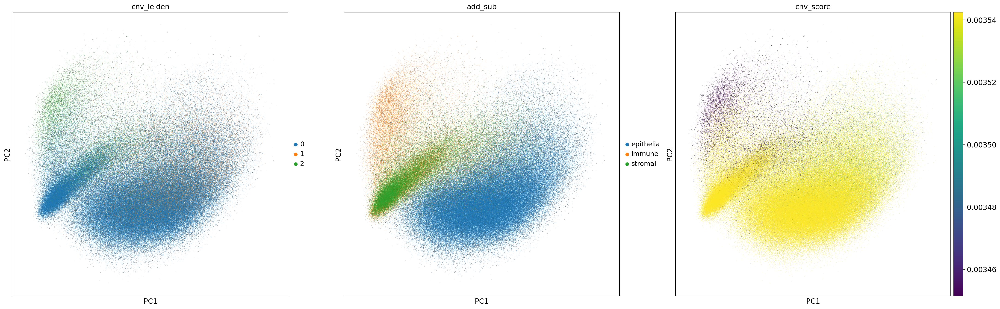

In [79]:
sc.pl.pca(adata, color=['cnv_leiden', 'add_sub', 'cnv_score'], s=1)

In [ ]:
sc.pl.umap(adata,color=['leiden','cnv_leiden', 'add_sub' ,'add_ist', 'cnv_score'], s=1)

Note: Unlike the B197 sample, the immune and stromal cells are not represented by one cnv cluster, but rather all three.

#### Plot spatial

In [28]:
import numpy as np
adata.obsm['spatial']=np.array(adata.obs.loc[:,['CenterX_global_px','CenterY_global_px']])

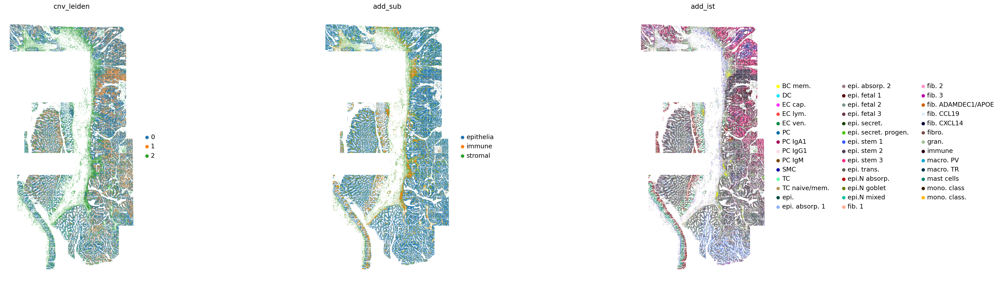

In [29]:
sc.settings.set_figure_params(figsize=(10, 10))
sc.pl.spatial(adata,color=['cnv_leiden', 'add_sub', 'add_ist'] ,spot_size=120,frameon=False)

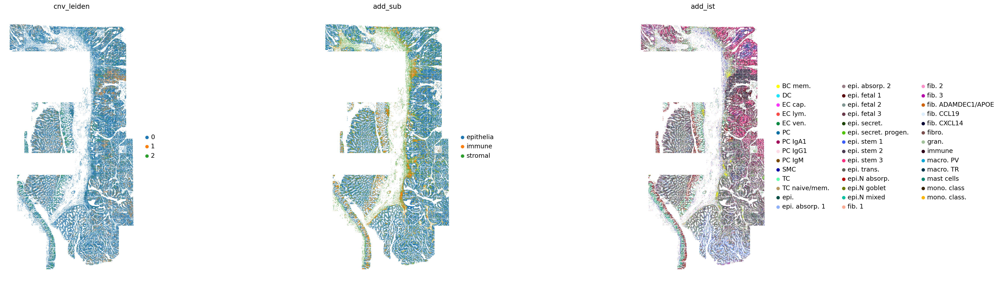

In [80]:
sc.settings.set_figure_params(figsize=(10, 10))
sc.pl.spatial(adata,color=['cnv_leiden', 'add_sub', 'add_ist'] ,spot_size=120,frameon=False)

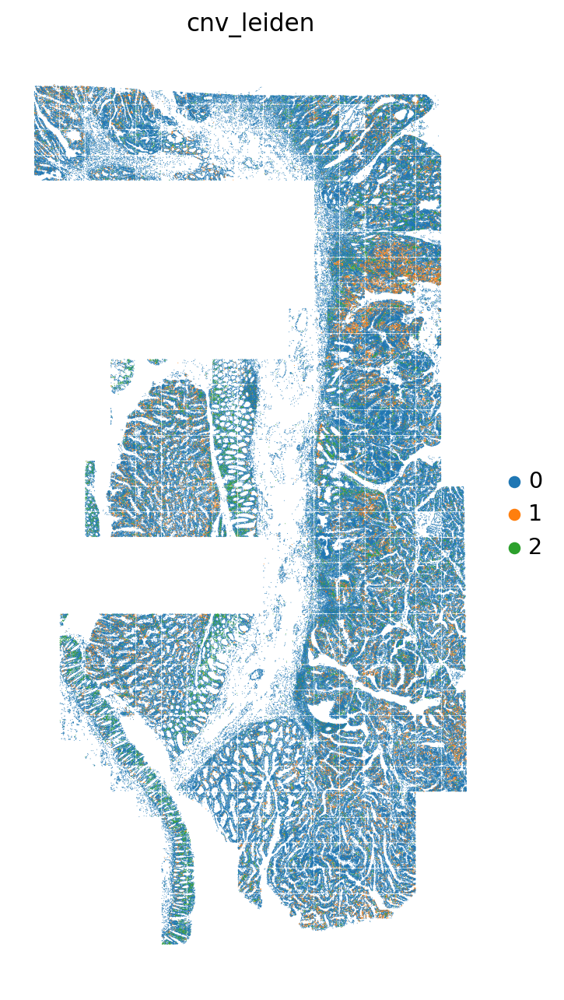

In [81]:
sc.settings.set_figure_params(figsize=(10, 10))
sc.pl.spatial(adata,color=['cnv_leiden'] ,spot_size=120,frameon=False)

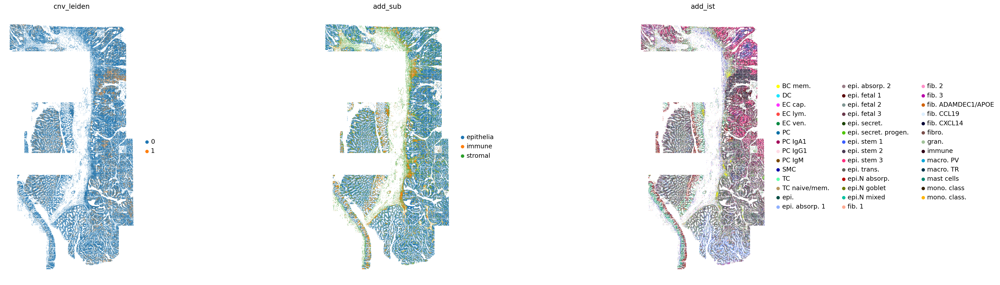

In [102]:
sc.settings.set_figure_params(figsize=(10, 10))
sc.pl.spatial(adata,color=['cnv_leiden', 'add_sub', 'add_ist'] ,spot_size=120,frameon=False)

In [84]:
adata.obs.tissue

cell
c_1_1_23        Colon
c_1_1_24        Colon
c_1_1_25        Colon
c_1_1_26        Colon
c_1_1_28        Colon
                ...  
c_1_384_1619    Colon
c_1_384_1620    Colon
c_1_384_1627    Colon
c_1_384_1640    Colon
c_1_384_1654    Colon
Name: tissue, Length: 497627, dtype: category
Categories (1, object): ['Colon']

Note: There seem to be more of the CNV cluster 1 (chr 6p gain) at a position with lots of "epi. stem2"or is it something else?

In [91]:
pd.DataFrame(adata.layers['raw'].toarray())

,0,1,2,3,4,5,6,7,8,9,...,18545,18546,18547,18548,18549,18550,18551,18552,18553,18554
0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0
1,0.0,0.0,0.310155,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0
2,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0
3,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0
4,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.0,1.210174,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
497622,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0
497623,0.0,0.0,1.023389,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0
497624,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.267971,0.0,0.000000,0.0,0.0,0.0,0.0
497625,0.0,0.0,0.890274,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0


In [92]:
pd.DataFrame(adata.layers['raw'])

,0
0,<Compressed Sparse Row sparse matrix of dtype ...
1,<Compressed Sparse Row sparse matrix of dtype ...
2,<Compressed Sparse Row sparse matrix of dtype ...
3,<Compressed Sparse Row sparse matrix of dtype ...
4,<Compressed Sparse Row sparse matrix of dtype ...
...,...
497622,<Compressed Sparse Row sparse matrix of dtype ...
497623,<Compressed Sparse Row sparse matrix of dtype ...
497624,<Compressed Sparse Row sparse matrix of dtype ...
497625,<Compressed Sparse Row sparse matrix of dtype ...


In [85]:
adata

AnnData object with n_obs × n_vars = 497627 × 18555
    obs: 'Unnamed: 0', 'fov', 'Area', 'AspectRatio', 'CenterX_local_px', 'CenterY_local_px', 'Width', 'Height', 'Mean.PanCK', 'Max.PanCK', 'Mean.CD68_CK8_18', 'Max.CD68_CK8_18', 'Mean.CD298_B2M', 'Max.CD298_B2M', 'Mean.CD45', 'Max.CD45', 'Mean.DAPI', 'Max.DAPI', 'cell_id', 'version', 'Run_name', 'Run_Tissue_name', 'tissue', 'Panel', 'assay_type', 'slide_ID', 'CenterX_global_px', 'CenterY_global_px', 'cell_ID', 'unassignedTranscripts', 'nCount_RNA', 'nFeature_RNA', 'nCount_negprobes', 'nFeature_negprobes', 'nCount_falsecode', 'nFeature_falsecode', 'Area.um2', 'cell', 'sid', 'add_cell_id', 'add_ist', 'add_sub', 'cnv_leiden', 'n_counts', 'cnv_score', 'leiden'
    var: 'Unnamed: 0', 'start', 'end', 'width', 'names', 'gene_id', 'symbol', 'ensg', 'chromosome'
    uns: 'cnv', 'cnv_neighbors', 'cnv_leiden', 'add_sub_colors', 'pca', 'dendrogram_add_sub', 'add_ist_colors', 'dendrogram_add_ist', 'cnv_leiden_colors', 'dendrogram_cnv_leiden', 'log